#Study of signal correlation in raft 

Goal : This Notebook will generate plots allowing to perform a diagnostic on the signal correlation between channels inside a raft   in BOT data .

Author : P.Antilogus

Version : 21st January 2021 

New : To be run  at NCSA


Method: 

Signal covariance divided by image flux ,  is estimated using flat pair differences at 2 fluxes 
the correlation  is estimated for each flux at 2 # scale : 
- at the pixel level 
- and to enlarge the correlation signal at the line level 

in practice the most interesting correlation is the one at line scale for high flux ...the other plots are there for control.

The code plots the correlation per sensor and per raft . 



In [1]:
%matplotlib inline

# system imports
import os
import time
from sys import exit 
import glob
#
#import pdb 
from astropy.time import Time

#  Specific package (display , pyfits ..) 
import numpy as np
import matplotlib.pyplot as plt
import astropy.io.fits as pyfits
# Firefly client imports   
#from IPython.display import IFrame
import matplotlib
matplotlib.rcParams['figure.dpi'] = 120

# LSST stack imports
from lsst.daf.persistence import Butler
#import lsst.afw.display as afwDisplay
#from lsst.ip.isr import IsrTask
#import lsst.afw.geom as afwGeom
#import lsst.afw.math as afwMath



In [2]:

# do we use the eotest resultes for the gain
display_in_electron=True
#
if display_in_electron :
    try : 
        from get_EO_analysis_results import get_EO_analysis_results
        from get_EO_analysis_files import get_EO_analysis_files
        from exploreFocalPlane import exploreFocalPlane
        from exploreRaft import exploreRaft
        from eTraveler.clientAPI.connection import Connection
        g = get_EO_analysis_results(db=DB_key[data_to_select['Data_location']])
        eotest_db=True
    except:
        print('No access to eotest DB , so the gain of all devices will be set to 1 ( 1 ADU counted as 1 e- )')
        eotest_db=False
else :
    eotest_db=False
    
# load the frame analysis code 
%run -i  /home/antilog/repos/eochar/python/lsst/eochar/bot_frame_op.py

# activate the butler
BOT_REPO_DIR = '/lsstdata/offline/teststand/BOT/gen2repo'
butler = Butler(BOT_REPO_DIR)

Warning, Data Catalog not available
No module named 'datacat'
No access to eotest DB , so the gain of all devices will be set to 1 ( 1 ADU counted as 1 e- )


In [3]:
# CONFIGURATION FOR THE CURRENT EXECUTION  ========================================
# ---- raft and associated run ============ To be updated if needed 
# 'raft' :  list of raft 
# 'run' :  list of run , ex : ['9876','9874']  (remark : run is a string )   for all run of this raft : '*' 
# 'sensor' :  list of sensor , ex ['S00','S01','S02'] 
# amplifier : list of amplifier , ex [1,2]  , for 1 to 16 you can use [-1] instead 
run_all=['12680']
#,'12606']
#
raft_itl=['R01', 'R02', 'R03', 'R10', 'R20', 'R41', 'R42', 'R43']
raft_e2v=['R11', 'R12', 'R13', 'R14', 'R21', 'R22', 'R23', 'R24', 'R30', 'R31', 'R32', 'R33', 'R34']
sensors_raft=['S00','S01','S02','S10','S11','S12','S20','S21','S22']
raft_corner=['R00','R04','R40','R44']
sensors_corner=['SG0','SG1','SW0','SW1']
sensors_8ch=['SW0','SW1']
#
all_sensors={}
#
for raft in raft_itl+raft_e2v:
    all_sensors[raft]=sensors_raft
for raft in raft_corner:
    all_sensors[raft]=sensors_corner
#
amplifier=[-1]
#
raft=raft_itl+raft_e2v+raft_corner
#raft=raft_corner
#raft=['R23']
#raft=['R10','R11','R12','R20','R21','R22','R30','R31','R32']
#raft=['R00']
##

# output file directory
output_data='/home/antilog/DATA/eochar6'


In [4]:
number_of_pair_per_run_max=40
# number of # flux (=3 1 BIAS , 2 super flat  here , for high and low sflat exposure fluxes )
nb_flux=3
run_visits=np.zeros((len(run_all),number_of_pair_per_run_max,2))
time_visits=np.zeros((len(run_all),nb_flux))
number_of_pair_per_run_ct=np.zeros((len(run_all),nb_flux),dtype=np.int16)
run=[]
for run_cur in run_all :
    # select 10 bias inages 
    visits_bias=butler.queryMetadata('raw', ['visit'], dataId={'run':run_cur,'testType': 'BIAS','imageType': 'BIAS'})
    if len(visits_bias) < 4 : 
        print('No good-enough BIAS in run ',run_cur)
        continue
    visits_bias.sort()
    nb_bias=min(16,len(visits_bias[2:]))
    #
    visits_flat=butler.queryMetadata('raw', ['visit'], dataId={'run':run_cur,'testType': 'SFLAT','imageType': 'FLAT'})
    if len(visits_flat) < 1 : 
        print('No good flat in run ',run_cur)
        continue
    #
    visits_flat.sort()
    visits=visits_bias[2:2+nb_bias]+visits_flat
    good_visits = []
    ptim=[]
    for visit1, visit2 in zip(visits[:-1:2], visits[1::2]):
        dId = {'visit': visit1, 'detector': 2}
        raw1 = butler.get('raw', **dId)
        time1 = raw1.getInfo().getVisitInfo().getExposureTime()

        # Get ISR data for second image
        dId = {'visit': visit2, 'detector': 2}
        raw2 = butler.get('raw', **dId)
        time2 = raw2.getInfo().getVisitInfo().getExposureTime()
        if abs(time1 - time2) > 0.01:
            print("Mismatched exptimes")
        else :
            good_visits.append((visit1,visit2))
            ptim.append(time1)
    run.append(run_cur)
    irun=len(run)-1
    iflux=nb_flux
    previous_time=ptim[-1]+1
    for ipair in range(len(ptim)-1,-1,-1) :
        if ptim[ipair] < previous_time :
            iflux-=1
            if iflux<0 :
                print('Error , the exposure sequence is not the expected one (increasing exposure time with ',nb_flux,' different exposures time). List of time :',ptim)
                exit('Execution stopped on Error')            
            number_of_pair_per_run_ct[irun,iflux]= ipair+1
            time_visits[irun,iflux]= ptim[ipair]
        run_visits[irun,ipair,0]=good_visits[ipair][0]
        run_visits[irun,ipair,1]=good_visits[ipair][1]
        previous_time=ptim[ipair]
    if iflux!=0 :
        print('Error , the exposure sequence is not the expected one (increasing exposure time with ',nb_flux,' different exposures time). List of time :',ptim)
        exit('Execution stopped on Error')            
#
#number_of_pair_per_run=2
print('Time distribution of the #pair ',ptim)
#
number_of_raft=len(raft)
number_of_run=len(run)
# set the max value for the tables creation
number_of_sensor=len(sensors_raft)
#how many amplifiers 
if -1 in amplifier :
    amplifier_list=np.array(range(1,17))
else :
    amplifier_list=np.array(amplifier)
amplifier_list.sort()
number_of_amplifier=len(amplifier_list)
if number_of_run < 1 : 
    print('No data found')
    raise 

Mismatched exptimes
Time distribution of the #pair  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 17.4246, 17.4246, 17.4246, 17.4246, 17.4246, 17.4246, 17.4246, 17.4246, 17.4246, 17.4246, 17.4246, 17.4246, 65.7951, 65.7951, 65.7951, 65.7951]


In [5]:
def find_pair(raft_cur):
    # compute the noise per image
    # Do all the fft plots if asked 
    # intialisation 
    number_of_raft_sensor=len(all_sensors[raft_cur])
    #
    all_file=np.zeros((number_of_run,number_of_raft_sensor,number_of_pair_per_run_max,2),dtype=np.object_)
    #         
    for irun in range(len(run)) : 
        run_cur=run[irun]
        #
        #
        t0=0
        #
        for iccd in range(number_of_raft_sensor) : 
            #
            for it in range(number_of_pair_per_run_ct[irun,-1]) : 
                for ifile in range(2) : 
                    dataId2 = {'visit': run_visits[irun,it,ifile], 'detectorName': all_sensors[raft_cur][iccd], 'raftName': raft_cur}
                    try : 
                        file=butler.get('raw_filename', dataId2)[0][:-3]
                    except : 
                        print('Error , data not found : ',dataId2)
                        break
                    all_file[irun,iccd,it,ifile]=file
    return  all_file          


In [7]:
def sig_cor_in_raft(raft_cur,all_file,show_raft=True,show_ccd=False,per_sensor=False):
    #
    if raft_cur in raft_corner :
        nb_amp_in_raft=48
    else :
        nb_amp_in_raft=144
    #
    number_of_raft_sensor=len(all_sensors[raft_cur])
    # labels for the plots
    label_txt=np.zeros((number_of_raft_sensor),dtype=np.object_)
    label_pos=np.zeros((number_of_raft_sensor))
    if number_of_raft_sensor==9 : 
        label_chan=np.zeros((18),dtype=np.object_)
        label_chan_pos=np.zeros((18))
    else : 
        label_chan=np.zeros((6),dtype=np.object_)
        label_chan_pos=np.zeros((6))    
    ch_cur=0
    ichan_lab=0
    for  iccd in range(number_of_raft_sensor) : 
            label_chan[ichan_lab]='%d' % (1)
            label_chan_pos[ichan_lab]=ch_cur
            ichan_lab+=1
            if ( all_sensors[raft_cur][iccd] in sensors_8ch ):
                number_of_amp_sensor=8
            else : 
                number_of_amp_sensor=16
                label_chan[ichan_lab]='%d' % (9)
                label_chan_pos[ichan_lab]=ch_cur+8
                ichan_lab+=1
            #
            label_txt[iccd]=all_sensors[raft_cur][iccd]
            label_pos[iccd]=ch_cur+number_of_amp_sensor/2-.5
            ch_cur+=number_of_amp_sensor
    # number of plots : number_of_pair_per_run * 2 flux per pair , so for each flux 1 line with 2 correlation plots , the first linee is reeserved for the flux per channel  
    plot_nb_line=1+2
    plot_nb_col=nb_flux
    #  
    # we will compute 2 covar between channel, 1 between pixel and one for a fraction of line 
    # we can split a line  in 1/1 (mean per line) and for e2v :  , 1/2 , 1/4 1/8 1/59 
    # line_split=1
    # Remark : this is a simplified version of the code, for eeochar use  
    #  we only compute covar between averaged signal per line (equive to line_split=1)
    split_text='per line'
    # get the amplifier shape for this raft
    fits=pyfits.open(all_file[0,0,0,0])
    first_line,first_p_over,first_col,first_s_over=image_area(fits)
    fits.close()
    #ncol=len(fits[1].data[100,:])
    #nline==len(fits[1].data[:,100])
    xf=first_col+20
    xl=first_s_over-20
    yf=first_line+50
    yl=first_p_over-20
    #
    ncol=xl-xf
    nline=yl-yf
    #
 
    #
    for irun in range(number_of_run) :
        # 
        #
        ImDiff=np.zeros((nb_amp_in_raft,nline,ncol))
        Flux=np.zeros((nb_flux,nb_amp_in_raft))
        good=np.zeros((nb_amp_in_raft,nline,ncol),dtype=bool)
        nb_good=np.zeros((nb_amp_in_raft))
        diff_tmean=np.zeros((nb_amp_in_raft))
        # 
        nb_b=(nline)   
        b_count=np.zeros((nb_amp_in_raft,nline))
        #
        #
        covarb=np.zeros((nb_amp_in_raft,nb_amp_in_raft))
        corb=np.zeros((nb_flux,nb_amp_in_raft,nb_amp_in_raft))
        covar=np.zeros((nb_amp_in_raft,nb_amp_in_raft))
        cor=np.zeros((nb_flux,nb_amp_in_raft,nb_amp_in_raft))
        cor_max=np.zeros((nb_flux,nb_amp_in_raft,nb_amp_in_raft))
        corb_max=np.zeros((nb_flux,nb_amp_in_raft,nb_amp_in_raft))
        for ipair in range(number_of_pair_per_run_ct[irun,-1]) :
            offset=0
            for jflux in range(nb_flux):
                if ipair < number_of_pair_per_run_ct[irun,jflux] :
                    iflux=jflux
                    break
                else :
                    offset=number_of_pair_per_run_ct[irun,jflux]
            nb_iflux=number_of_pair_per_run_ct[irun,iflux]-offset
            #
            ch_cur=0
            for iccd in range(number_of_raft_sensor) :
                if ( all_sensors[raft_cur][iccd] in sensors_8ch ):
                    number_of_amp_sensor=8
                else : 
                    number_of_amp_sensor=16
                #
                fname=[all_file[irun,iccd,ipair,0],all_file[irun,iccd,ipair,1]]
                if (ipair+1)%10==0 and (iccd+1)%5==0 :
                    print(Time.now(),' Run:',irun,' Raft:',raft_cur,'; pair of file number:',ipair+1,' among:',number_of_pair_per_run_ct[irun,-1],' current raft channels ',ch_cur+1,' processed among ' , nb_amp_in_raft)
                    all=InFile(dirall=fname,Slow=False,verbose=True)
                else :
                    all=InFile(dirall=fname,Slow=False,verbose=False)                    
                #
                for k in range(number_of_amp_sensor) :
                    # select-truncate  the image for the channel ch_cur
                    Im0=np.median(all.all_file[0].Image[k][yf:yl,xf:xl])
                    Im1=np.median(all.all_file[1].Image[k][yf:yl,xf:xl])
                    if iflux==0 : 
                        # don't re-scale in flux for bias 
                        ImDiff[ch_cur]=(all.all_file[0].Image[k][yf:yl,xf:xl]-all.all_file[1].Image[k][yf:yl,xf:xl])
                    else :     
                        ImDiff[ch_cur]=((all.all_file[0].Image[k][yf:yl,xf:xl]/Im0-all.all_file[1].Image[k][yf:yl,xf:xl]/Im1)*(Im0+Im1)/2.)
                    Flux[iflux,ch_cur]+=(Im0+Im1)/2./nb_iflux
                    av=np.mean((ImDiff[ch_cur][:,:]))
                    std=np.std((ImDiff[ch_cur][:,:]))
                    # All measurements are done with signal within 4 sigma to the <> . 
                    good[ch_cur,:,:] = (np.abs(ImDiff[ch_cur]-av)<4.*std) 
                    nb_good[ch_cur]=np.sum(good[ch_cur,:,:])
                    diff_tmean[ch_cur]=np.sum(ImDiff[ch_cur]*good[ch_cur,:,:])/nb_good[ch_cur]
                    # 
                    b_count[ch_cur,:]=np.sum(good[ch_cur,:,:],axis=1)
                    #
                    ch_cur1=0
                    for iccd1 in range(number_of_raft_sensor) :
                        if ch_cur1 > ch_cur : break
                        if ( all_sensors[raft_cur][iccd1] in sensors_8ch ):
                            number_of_amp_sensor_1=8
                        else : 
                            number_of_amp_sensor_1=16
                        #
                        for l in range(number_of_amp_sensor_1) :
                            if ch_cur1 > ch_cur : break
                            # compute covar betwen pixels of # channels (ch_cur and ch_cur1 ) 
                            count=np.sum(good[ch_cur,:,:]*good[ch_cur1,:,:])
                            covar[ch_cur,ch_cur1]=np.sum((ImDiff[ch_cur,:,:]-diff_tmean[ch_cur])*good[ch_cur,:,:]
                                             *(ImDiff[ch_cur1,:,:]-diff_tmean[ch_cur1])*good[ch_cur1,:,:]/count)
                            covar[ch_cur1,ch_cur]=covar[ch_cur,ch_cur1]
                            # compute covar between <pixel> per line between # channels (ch_cur and ch_cur1 ) 
                            covarb[ch_cur,ch_cur1]=np.sum(
        (np.sum(ImDiff[ch_cur,:,:]*good[ch_cur,:,:],axis=1)/b_count[ch_cur,:]-diff_tmean[ch_cur])
       *(np.sum(ImDiff[ch_cur1,:,:]*good[ch_cur1,:,:],axis=1)/b_count[ch_cur1,:]-diff_tmean[ch_cur1])
            )/nb_b
                            covarb[ch_cur1,ch_cur]=covarb[ch_cur,ch_cur1]
                            ch_cur1+=1
                    ch_cur+=1
            ch_cur=0
            for iccd in range(number_of_raft_sensor) :
                if ( all_sensors[raft_cur][iccd] in sensors_8ch ):
                    number_of_amp_sensor=8
                else : 
                    number_of_amp_sensor=16
                #
                for k in range(number_of_amp_sensor) :
                    ch_cur1=0
                    for iccd1 in range(number_of_raft_sensor) :
                        if ch_cur1 > ch_cur : break
                        if ( all_sensors[raft_cur][iccd1] in sensors_8ch ):
                            number_of_amp_sensor_1=8
                        else : 
                            number_of_amp_sensor_1=16
                        #
                        for l in range(number_of_amp_sensor_1) :
                            if ch_cur1 > ch_cur : break
                            # we /2 to take into account that we computed this with image dif , but are interested by single image stat 
                            cor[iflux,ch_cur1,ch_cur]+=covar[ch_cur1,ch_cur]/nb_iflux/2.
                            corb[iflux,ch_cur1,ch_cur]+=covarb[ch_cur1,ch_cur]/nb_iflux/2.
#                            cor[iflux,ch_cur1,ch_cur]+=covar[ch_cur1,ch_cur]/(Flux[iflux,ch_cur]+Flux[iflux,ch_cur1])*2./nb_iflux
#                            corb[iflux,ch_cur1,ch_cur]+=covarb[ch_cur1,ch_cur]/(Flux[iflux,ch_cur]+Flux[iflux,ch_cur1])*2./nb_iflux
                            ch_cur1+=1
                    ch_cur+=1
            #
        for iflux in range(nb_flux):
            ch_cur=0
            for iccd in range(number_of_raft_sensor) :
                if ( all_sensors[raft_cur][iccd] in sensors_8ch ):
                    number_of_amp_sensor=8
                else : 
                    number_of_amp_sensor=16
                #
                for k in range(number_of_amp_sensor) :
                    ch_cur1=0
                    for iccd1 in range(number_of_raft_sensor) :
                        if ch_cur1 > ch_cur : break
                        if ( all_sensors[raft_cur][iccd1] in sensors_8ch ):
                            number_of_amp_sensor_1=8
                        else : 
                            number_of_amp_sensor_1=16
                        #
                        for l in range(number_of_amp_sensor_1) :
                            if ch_cur1 > ch_cur : break
                            cor[iflux,ch_cur,ch_cur1]=cor[iflux,ch_cur1,ch_cur]
                            corb[iflux,ch_cur,ch_cur1]=corb[iflux,ch_cur1,ch_cur]
                            if ch_cur != ch_cur1 :
                                cor_max[iflux,ch_cur,ch_cur1]=cor[iflux,ch_cur1,ch_cur]
                                corb_max[iflux,ch_cur,ch_cur1]=corb[iflux,ch_cur1,ch_cur]
                                cor_max[iflux,ch_cur1,ch_cur]=cor[iflux,ch_cur1,ch_cur]
                                corb_max[iflux,ch_cur1,ch_cur]=corb[iflux,ch_cur1,ch_cur]
                            ch_cur1+=1
                    ch_cur+=1
        
        # per CCD plot 
        if per_sensor :
            chs=0
            for iccd in range(number_of_raft_sensor) :
                if ( all_sensors[raft_cur][iccd] in sensors_8ch ):
                        number_of_amp_sensor=8
                else : 
                        number_of_amp_sensor=16
                fig=plt.figure(figsize=[15,15])
                fig.suptitle('Signal channels cov in raft '+raft_cur+' ccd '+all_sensors[raft_cur][iccd]+' for run '+run[irun])
                #
                chl=chs+number_of_amp_sensor
                for iflux in range(nb_flux):
                    loc=plot_nb_col+1+iflux
                    if iflux==0 : 
                        title='BIAS channels cov(pixel)' 
                    else:
                        title='Channels cov(pixel), exp. %fs' %(time_visits[irun,iflux])
                    fig.add_subplot(plot_nb_line,plot_nb_col,loc,title=title)
                    cmin=np.min(cor[iflux,chs:chl,chs:chl])
                    #if cmin<-.1 : cmin=-1.
                    cmax=np.max(cor_max[iflux,chs:chl,chs:chl])
                    #cmin=min(-.1,np.min(cor[ipair,chs:chl,chs:chl]))
                    #if cmin<-.1 : cmin=-1.
                    #cmax=int(cor_max[iccd,ipair]*10)/10.+.1
                    plt.imshow(cor[iflux,chs:chl,chs:chl],cmap=matplotlib.cm.nipy_spectral,origin='lower',vmin=cmin,vmax=cmax)
                    #plt.imshow(cor[irun,:,:],cmap=matplotlib.cm.nipy_spectral,shape=(144,144),origin='lower',vmin=-.15,vmax=1.)
                    #plt.xticks(label_pos,label_txt)
                    #plt.yticks(label_pos,label_txt)
                    plt.colorbar()
                    #
                    loc=(plot_nb_col)*2+1+iflux
                    if iflux==0 : 
                        title='BIAS channels cov(line)' 
                    else:
                        title='Channels cov(line), exp. %fs' %(time_visits[irun,iflux])
                    fig.add_subplot(plot_nb_line,plot_nb_col,loc,title=title)
                    #cmin=min(-.1,np.min(corb[ipair,chs:chl,chs:chl]))
                    #if cmin<-.1 : cmin=-1.
                    #cmax=int(corb_max[iccd,ipair]*10)/10.+.1
                    cmin=np.min(corb[iflux,chs:chl,chs:chl])
                    #if cmin<-.1 : cmin=-1.
                    cmax=np.max(corb_max[iflux,chs:chl,chs:chl])
                    plt.imshow(corb[iflux,chs:chl,chs:chl],cmap=matplotlib.cm.nipy_spectral,origin='lower',vmin=cmin,vmax=cmax)
                    #plt.imshow(cor[irun,:,:],cmap=matplotlib.cm.nipy_spectral,shape=(144,144),origin='lower',vmin=-.15,vmax=1.)
                    #plt.xticks(label_pos,label_txt)
                    #plt.yticks(label_pos,label_txt)
                    plt.colorbar()
                #
                ax1=fig.add_subplot(plot_nb_line,1,1)
                #ax2=ax1.twiny()
                #plt.tick_params(axis='x',top='on',labeltop='on')
                #,bottom='off',labelbottom='off')
                #
                for iflux in range(nb_flux) :
                    if iflux==0 :
                        label='<BIAS>' 
                        ax1.plot(range(number_of_amp_sensor),Flux[iflux,chs:chl],label=label)
                        label='Var(Signal_pixel) BIAS' 
                        ax1.plot(range(number_of_amp_sensor),np.diag(cor[iflux,chs:chl,chs:chl]),label=label)
                        label='Var(Signal_line)  BIAS' 
                        ax1.plot(range(number_of_amp_sensor),np.diag(corb[iflux,chs:chl,chs:chl]),label=label)
                    else :    
                        label='<flux> exp. %fs' %(time_visits[irun,iflux])
                        ax1.plot(range(number_of_amp_sensor),Flux[iflux,chs:chl],label=label)
                        label='Var(flux_pixel) exp. %fs' %(time_visits[irun,iflux])
                        ax1.plot(range(number_of_amp_sensor),np.diag(cor[iflux,chs:chl,chs:chl]),label=label)
                        label='Var(flux_line) exp. %fs' %(time_visits[irun,iflux])
                        ax1.plot(range(number_of_amp_sensor),np.diag(corb[iflux,chs:chl,chs:chl]),label=label)
                ax1.set_yscale('log')
                ax1.legend(bbox_to_anchor=(1.05, 1),loc=2, borderaxespad=0.)
                ax1.set_ylabel('Signal mean (var) in image in ADU (ADU**2)')
                ax1.set_xlabel('Channel (hdu-1)')
                #plt.show()
                if show_ccd : plt.show()
                root_plt=os.path.join(output_data,run[irun],raft_cur,all_sensors[raft_cur][iccd])
                os.makedirs(root_plt,exist_ok=True)
                plotfile=os.path.join(root_plt,'cor_in_signal.png')
                print (plotfile)
                fig.savefig(plotfile,bbox_inches='tight')
                plt.close(fig) 
                #
                chs=chl
        # per raft plot 
        fig=plt.figure(figsize=[15,15])
        fig.suptitle('Signal channels cov  in raft :'+raft_cur+' for run '+run[irun])
        #
        for iflux in range(nb_flux):
            loc=plot_nb_col+1+iflux
            if iflux==0 : 
                title='BIAS channels cov(pixel)' 
            else:
                title='Channels cov(pixel), exp. %fs' %(time_visits[irun,iflux])
            fig.add_subplot(plot_nb_line,plot_nb_col,loc,title=title)
            cmin=np.min(cor[iflux,:,:])
            #if cmin<-.1 : cmin=-1.
            cmax=np.max(cor_max[iflux,:,:])
            #cmin=min(-.1,np.min(cor[ipair,:,:]))
            #if cmin<-.1 : cmin=-1.
            #cmax=int(np.max(cor_max[:,ipair])*10)/10.+.1
            plt.imshow(cor[iflux,:,:],cmap=matplotlib.cm.nipy_spectral,origin='lower',vmin=cmin,vmax=cmax)
            #plt.imshow(cor[irun,:,:],cmap=matplotlib.cm.nipy_spectral,shape=(144,144),origin='lower',vmin=-.15,vmax=1.)
            plt.xticks(label_pos,label_txt)
            plt.yticks(label_pos,label_txt)
            plt.colorbar()
            #
            loc=(plot_nb_col)*2+1+iflux
            if iflux==0 : 
                title='BIAS channels cov(line)' 
            else:
                title='Channels cov(line), exp. %fs' %(time_visits[irun,iflux])
            fig.add_subplot(plot_nb_line,plot_nb_col,loc,title=title)
            #cmin=min(-.1,np.min(corb[ipair,:,:]))
            #if cmin<-.1 : cmin=-1.
            #cmax=int(np.max(corb_max[:,ipair])*10)/10.+.1
            cmin=np.min(corb[iflux,:,:])
            #if cmin<-.1 : cmin=-1.
            cmax=np.max(corb_max[iflux,:,:])
            #
            plt.imshow(corb[iflux,:,:],cmap=matplotlib.cm.nipy_spectral,origin='lower',vmin=cmin,vmax=cmax)
            #plt.imshow(cor[irun,:,:],cmap=matplotlib.cm.nipy_spectral,shape=(144,144),origin='lower',vmin=-.15,vmax=1.)
            plt.xticks(label_pos,label_txt)
            plt.yticks(label_pos,label_txt)
            plt.colorbar()
        #
        ax1=fig.add_subplot(plot_nb_line,1,1)
        ax2=ax1.twiny()
        #plt.tick_params(axis='x',top='on',labeltop='on')
        #,bottom='off',labelbottom='off')
        #
        for iflux in range(nb_flux) :
            if iflux==0 :
                label='<BIAS>' 
                ax1.plot(range(nb_amp_in_raft),Flux[iflux,:],label=label)
                label='Var(Signal_pixel) BIAS' 
                ax1.plot(range(nb_amp_in_raft),np.diag(cor[iflux,:,:]),label=label)
                label='Var(Signal_line)  BIAS' 
                ax1.plot(range(nb_amp_in_raft),np.diag(corb[iflux,:,:]),label=label)
            else :    
                label='<flux> exp. %fs' %(time_visits[irun,iflux])
                ax1.plot(range(nb_amp_in_raft),Flux[iflux,:],label=label)
                label='Var(flux_pixel) exp. %fs' %(time_visits[irun,iflux])
                ax1.plot(range(nb_amp_in_raft),np.diag(cor[iflux,:,:]),label=label)
                label='Var(flux_line) exp. %fs' %(time_visits[irun,iflux])
                ax1.plot(range(nb_amp_in_raft),np.diag(corb[iflux,:,:]),label=label)
        ax1.set_yscale('log')
        ax1.legend(bbox_to_anchor=(1.05, 1),loc=2, borderaxespad=0.)
        ax1.set_ylabel('Signal mean (var) in image in ADU (ADU**2)')
        ax1.set_xlabel('Sensor')
        ax1.set_xticks(label_pos)
        ax1.set_xticklabels(label_txt)
        ax2.set_xlim(ax1.get_xlim())
        ax2.tick_params(labeltop='on')
        ax2.set_xticks(label_chan_pos)
        ax2.set_xticklabels(label_chan)
        plt.xlabel('Channel')
        title=''
        #plt.show()
        if show_raft : plt.show()
        root_plt=os.path.join(output_data,run[irun],raft_cur)
        os.makedirs(root_plt,exist_ok=True)
        plotfile=os.path.join(root_plt,'cor_in_signal.png')
        print (plotfile)
        fig.savefig(plotfile,bbox_inches='tight')
        plt.close(fig) 
#    return noise,noise_std,cor
    return 

2021-01-22 21:50:18.854503  Run: 0  Raft: R01 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R01-S11-det004.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R01-S11-det004.fits 
2021-01-22 22:08:07.576101  Run: 0  Raft: R01 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R01-S11-det004.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R01-S11-det004.fits 
/home/antilog/DATA/eochar6/12680/R01/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R01/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R01/S02/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R01/S10/cor_in

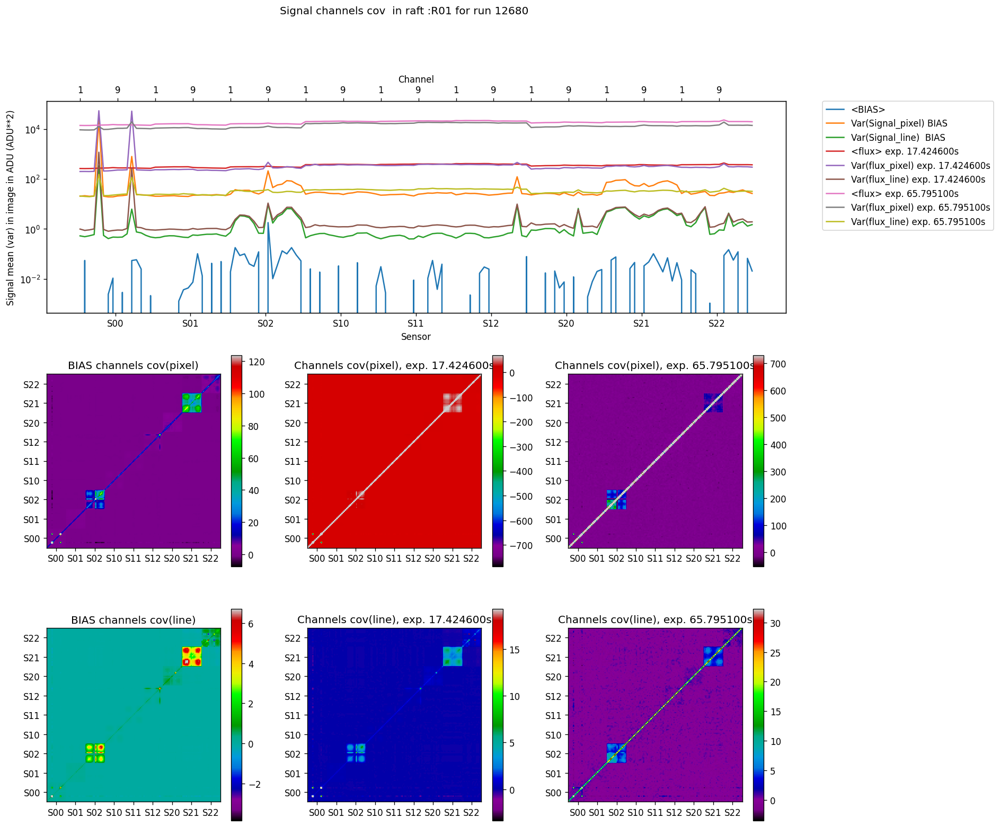

/home/antilog/DATA/eochar6/12680/R01/cor_in_signal.png
2021-01-22 22:34:49.325034  Run: 0  Raft: R02 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R02-S11-det013.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R02-S11-det013.fits 
2021-01-22 22:52:58.292865  Run: 0  Raft: R02 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R02-S11-det013.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R02-S11-det013.fits 
/home/antilog/DATA/eochar6/12680/R02/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R02/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R02/S02/cor_in_sig

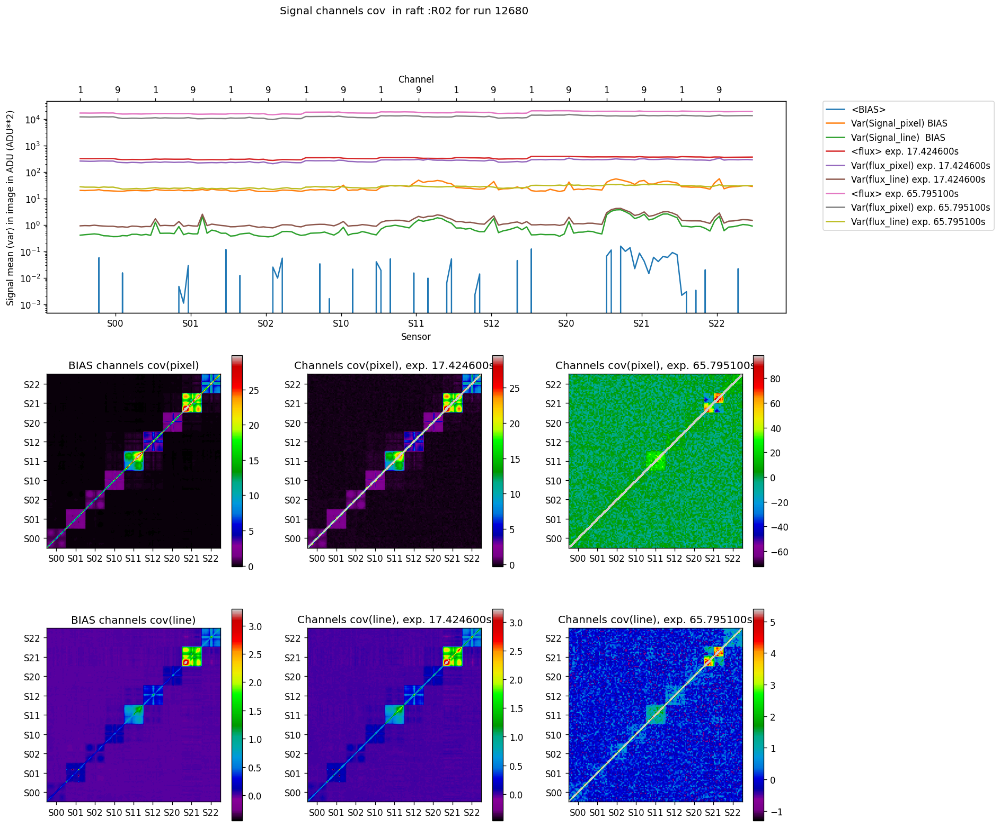

/home/antilog/DATA/eochar6/12680/R02/cor_in_signal.png
2021-01-22 23:20:20.971402  Run: 0  Raft: R03 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R03-S11-det022.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R03-S11-det022.fits 
2021-01-22 23:38:16.341655  Run: 0  Raft: R03 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R03-S11-det022.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R03-S11-det022.fits 
/home/antilog/DATA/eochar6/12680/R03/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R03/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R03/S02/cor_in_sig

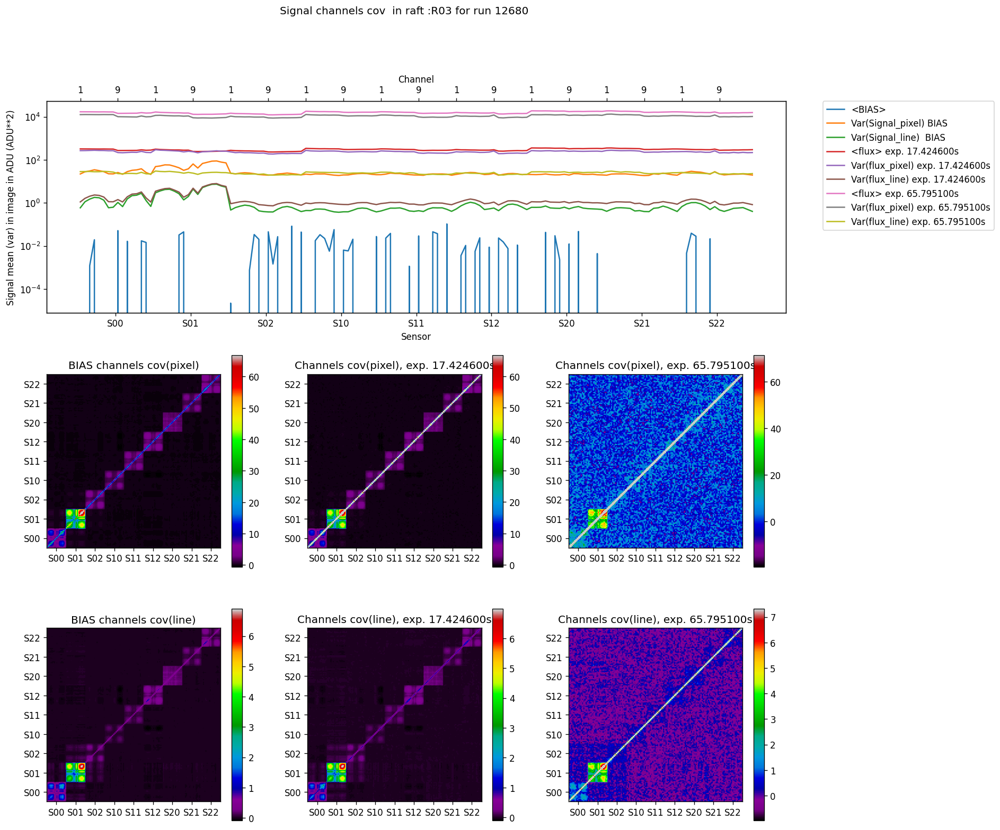

/home/antilog/DATA/eochar6/12680/R03/cor_in_signal.png
2021-01-23 00:05:11.280838  Run: 0  Raft: R10 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R10-S11-det031.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R10-S11-det031.fits 
2021-01-23 00:23:19.401530  Run: 0  Raft: R10 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R10-S11-det031.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R10-S11-det031.fits 
/home/antilog/DATA/eochar6/12680/R10/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R10/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R10/S02/cor_in_sig

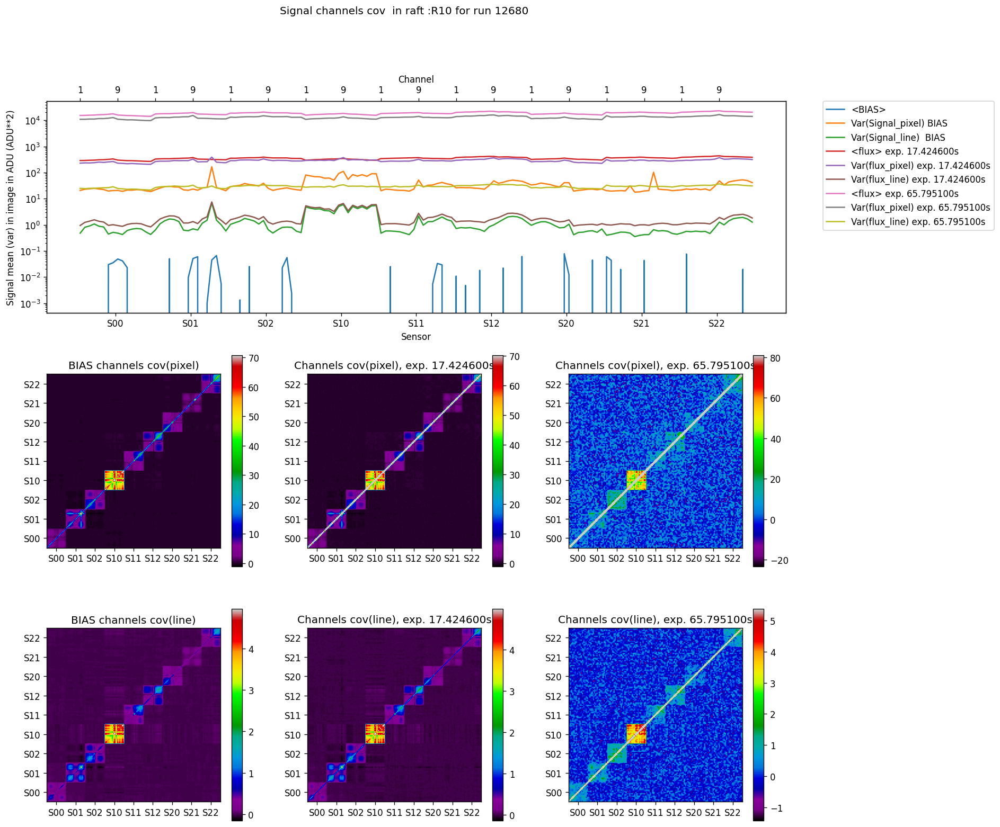

/home/antilog/DATA/eochar6/12680/R10/cor_in_signal.png
2021-01-23 00:50:26.856475  Run: 0  Raft: R20 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R20-S11-det076.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R20-S11-det076.fits 
2021-01-23 01:08:43.131210  Run: 0  Raft: R20 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R20-S11-det076.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R20-S11-det076.fits 
/home/antilog/DATA/eochar6/12680/R20/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R20/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R20/S02/cor_in_sig

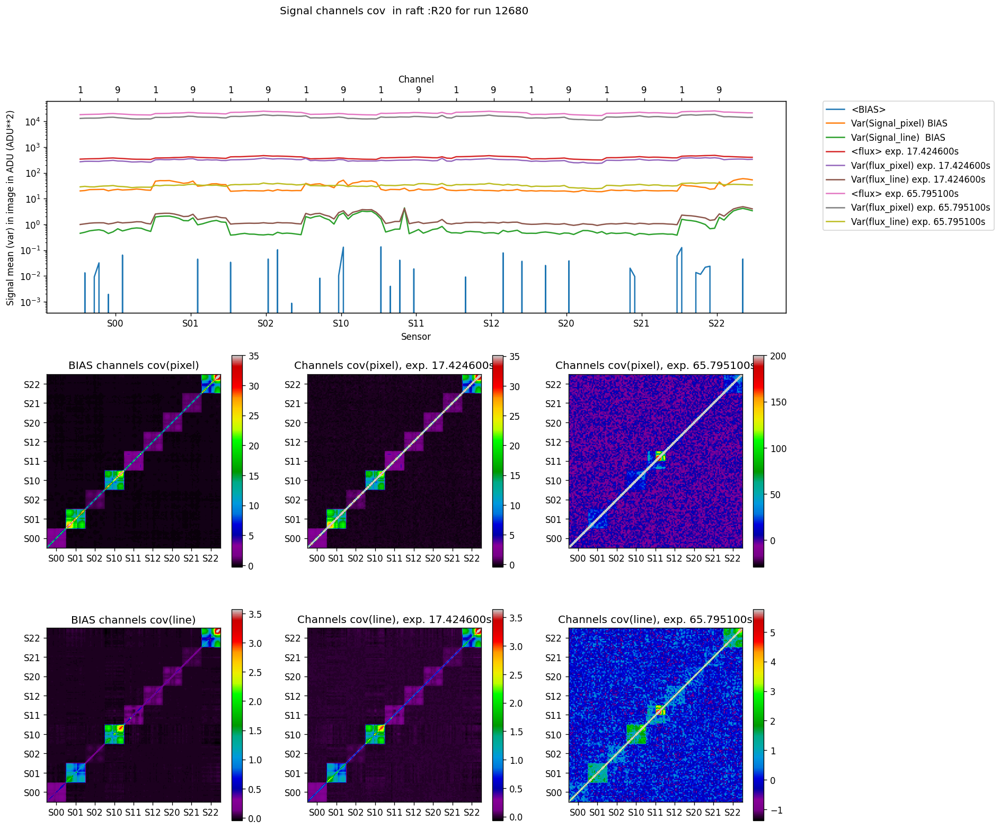

/home/antilog/DATA/eochar6/12680/R20/cor_in_signal.png


/home/antilog/repos/eochar/python/lsst/eochar/bot_frame_op.py:140: RuntimeWarning: invalid value encountered in true_divide
  self.all_file.append(actfile(fitsfile,Slow))
/home/antilog/repos/eochar/python/lsst/eochar/bot_frame_op.py:141: RuntimeWarning: invalid value encountered in true_divide
  self.selection.append((selection,filenamed))


2021-01-23 01:35:50.032818  Run: 0  Raft: R41 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R41-S11-det166.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R41-S11-det166.fits 
2021-01-23 01:53:42.809782  Run: 0  Raft: R41 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R41-S11-det166.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R41-S11-det166.fits 
/home/antilog/DATA/eochar6/12680/R41/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R41/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R41/S02/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R41/S10/cor_in

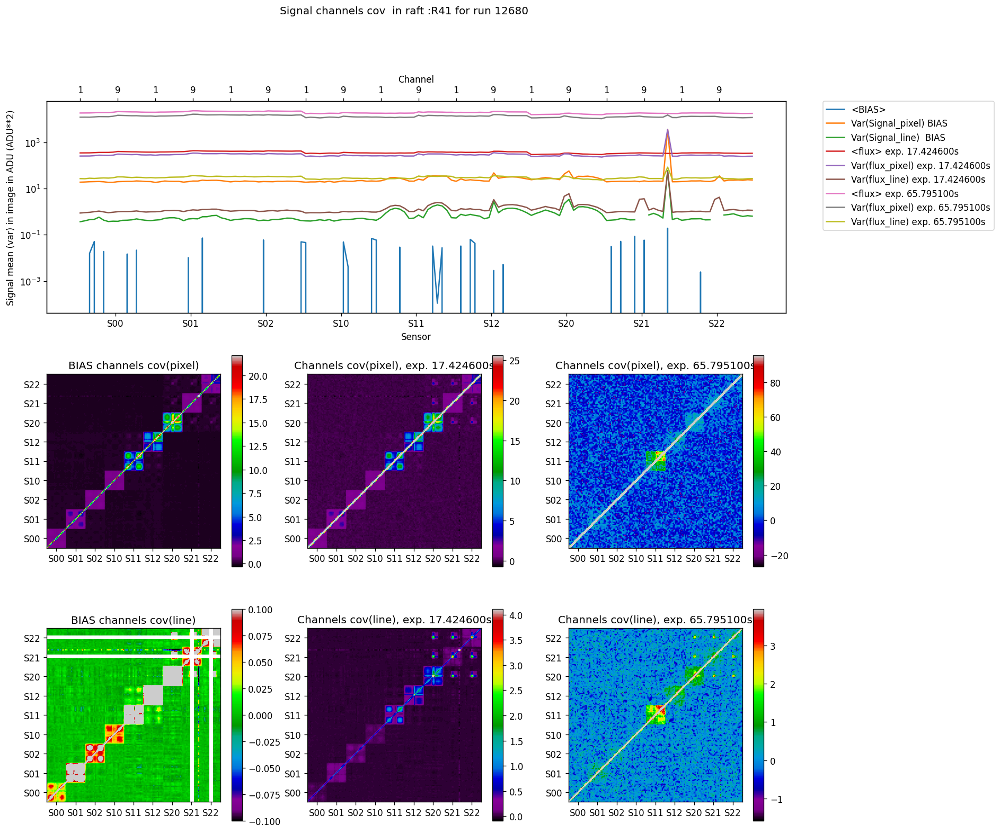

/home/antilog/DATA/eochar6/12680/R41/cor_in_signal.png


/home/antilog/repos/eochar/python/lsst/eochar/bot_frame_op.py:140: RuntimeWarning: invalid value encountered in true_divide
  self.all_file.append(actfile(fitsfile,Slow))
/home/antilog/repos/eochar/python/lsst/eochar/bot_frame_op.py:141: RuntimeWarning: invalid value encountered in true_divide
  self.selection.append((selection,filenamed))


2021-01-23 02:20:58.015975  Run: 0  Raft: R42 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R42-S11-det175.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R42-S11-det175.fits 
2021-01-23 02:39:07.298184  Run: 0  Raft: R42 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R42-S11-det175.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R42-S11-det175.fits 
/home/antilog/DATA/eochar6/12680/R42/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R42/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R42/S02/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R42/S10/cor_in

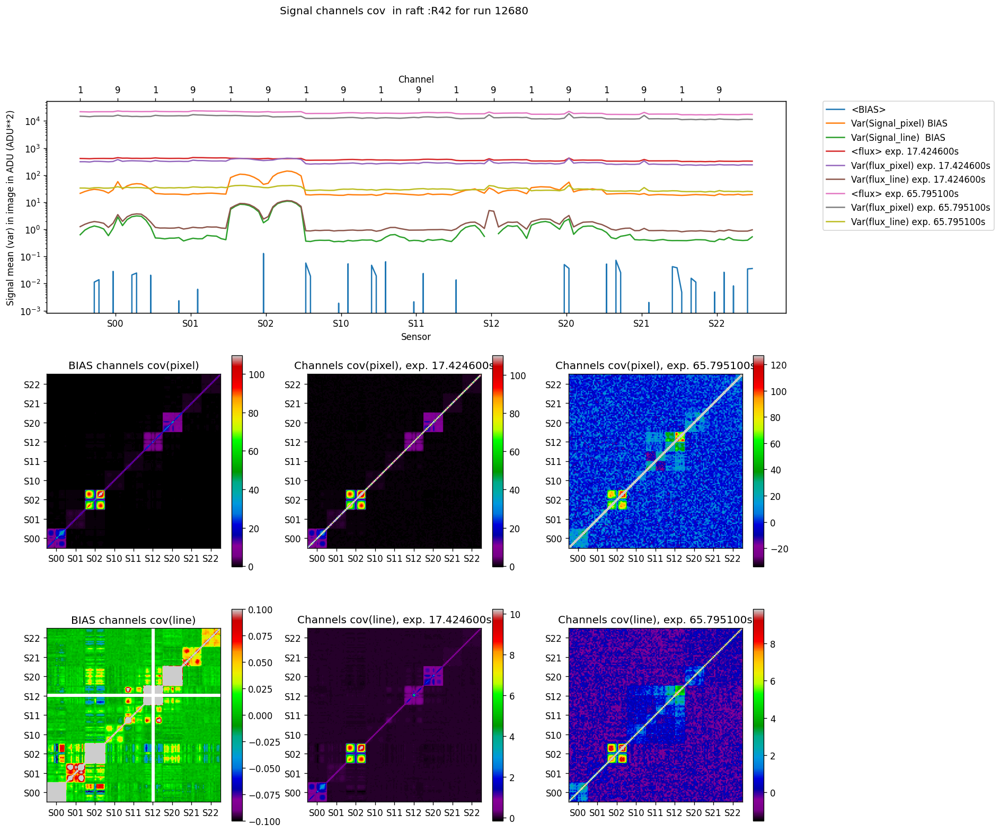

/home/antilog/DATA/eochar6/12680/R42/cor_in_signal.png
2021-01-23 03:06:28.381114  Run: 0  Raft: R43 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R43-S11-det184.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R43-S11-det184.fits 
2021-01-23 03:24:39.544321  Run: 0  Raft: R43 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R43-S11-det184.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R43-S11-det184.fits 
/home/antilog/DATA/eochar6/12680/R43/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R43/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R43/S02/cor_in_sig

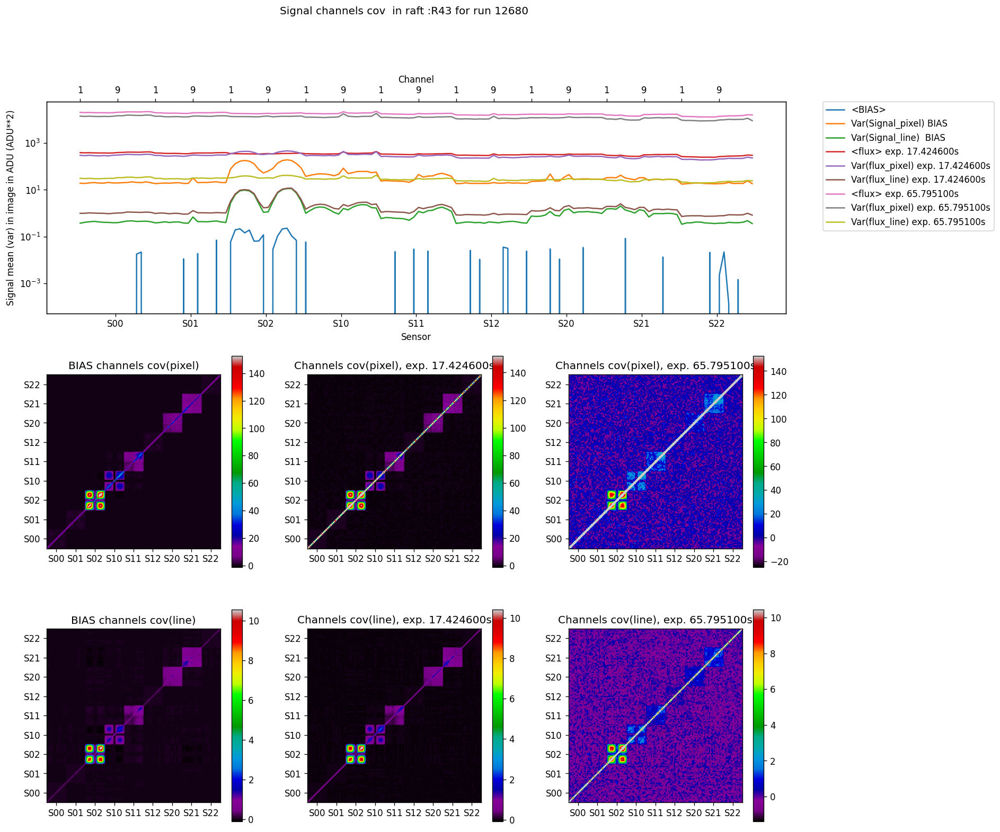

/home/antilog/DATA/eochar6/12680/R43/cor_in_signal.png
2021-01-23 03:51:37.281146  Run: 0  Raft: R11 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R11-S11-det040.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R11-S11-det040.fits 
2021-01-23 04:09:51.222148  Run: 0  Raft: R11 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R11-S11-det040.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R11-S11-det040.fits 
/home/antilog/DATA/eochar6/12680/R11/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R11/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R11/S02/cor_in_sig

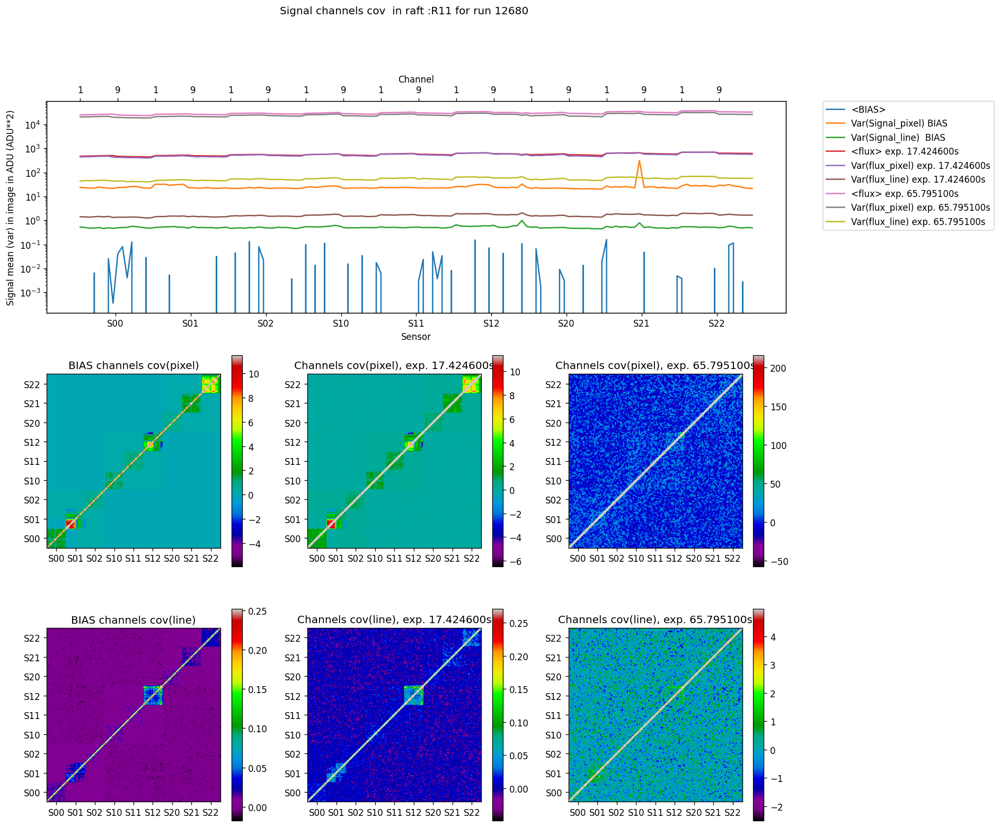

/home/antilog/DATA/eochar6/12680/R11/cor_in_signal.png
2021-01-23 04:37:06.240640  Run: 0  Raft: R12 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R12-S11-det049.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R12-S11-det049.fits 
2021-01-23 04:54:56.979307  Run: 0  Raft: R12 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R12-S11-det049.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R12-S11-det049.fits 
/home/antilog/DATA/eochar6/12680/R12/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R12/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R12/S02/cor_in_sig

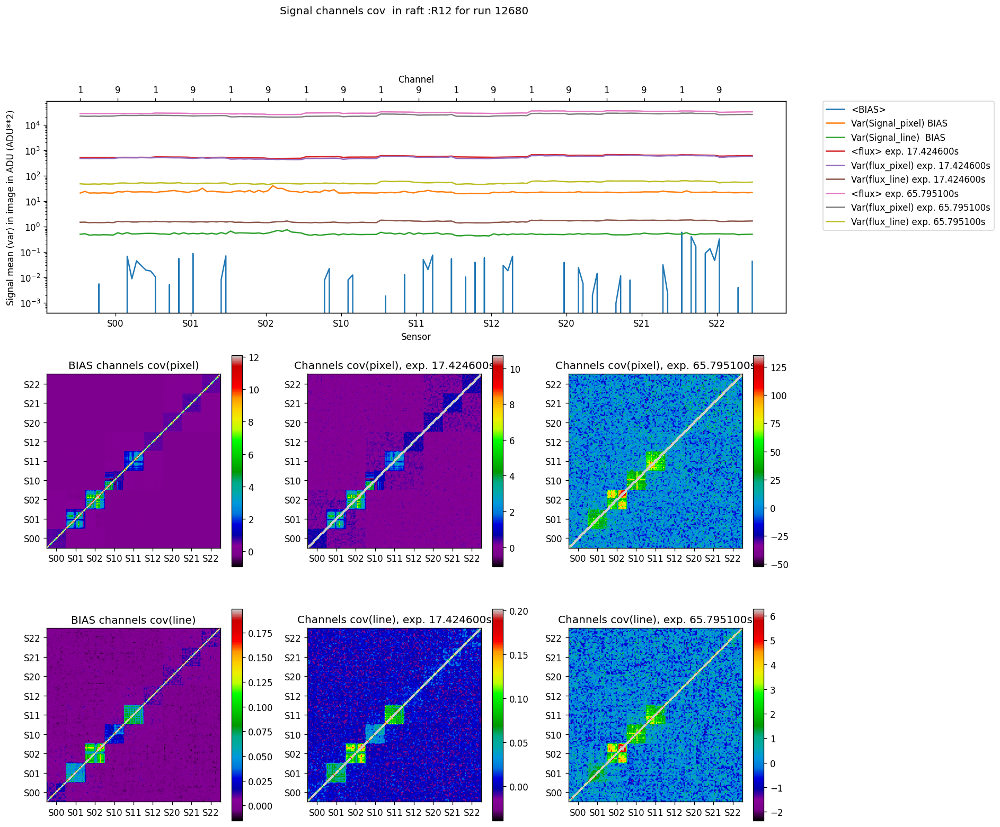

/home/antilog/DATA/eochar6/12680/R12/cor_in_signal.png
2021-01-23 05:21:58.820058  Run: 0  Raft: R13 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R13-S11-det058.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R13-S11-det058.fits 
2021-01-23 05:39:59.792525  Run: 0  Raft: R13 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R13-S11-det058.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R13-S11-det058.fits 
/home/antilog/DATA/eochar6/12680/R13/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R13/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R13/S02/cor_in_sig

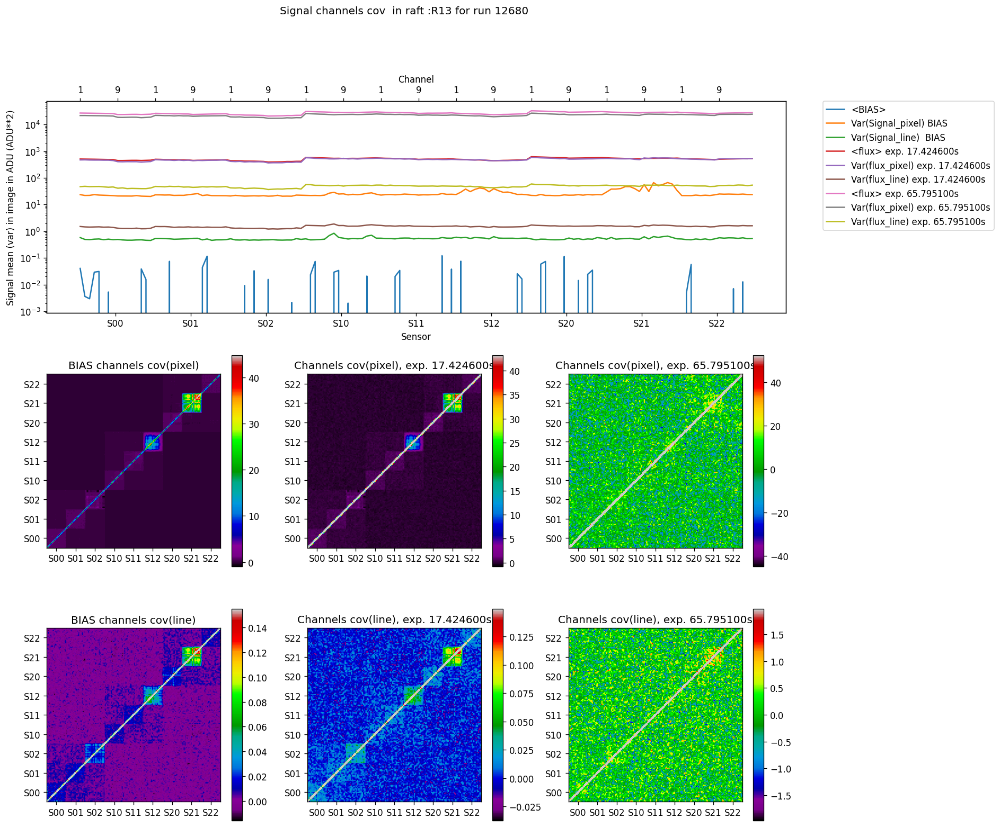

/home/antilog/DATA/eochar6/12680/R13/cor_in_signal.png
2021-01-23 06:07:18.853438  Run: 0  Raft: R14 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R14-S11-det067.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R14-S11-det067.fits 
2021-01-23 06:25:21.080163  Run: 0  Raft: R14 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R14-S11-det067.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R14-S11-det067.fits 
/home/antilog/DATA/eochar6/12680/R14/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R14/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R14/S02/cor_in_sig

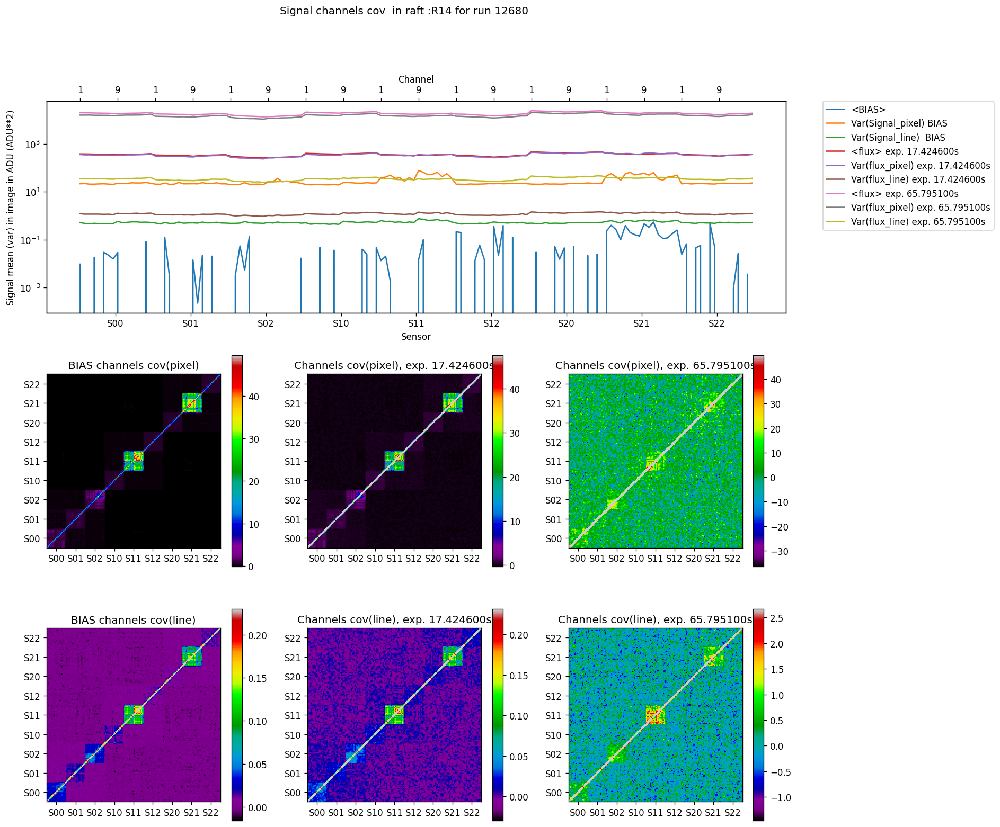

/home/antilog/DATA/eochar6/12680/R14/cor_in_signal.png
2021-01-23 06:52:24.908488  Run: 0  Raft: R21 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R21-S11-det085.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R21-S11-det085.fits 
2021-01-23 07:10:43.331119  Run: 0  Raft: R21 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R21-S11-det085.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R21-S11-det085.fits 
/home/antilog/DATA/eochar6/12680/R21/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R21/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R21/S02/cor_in_sig

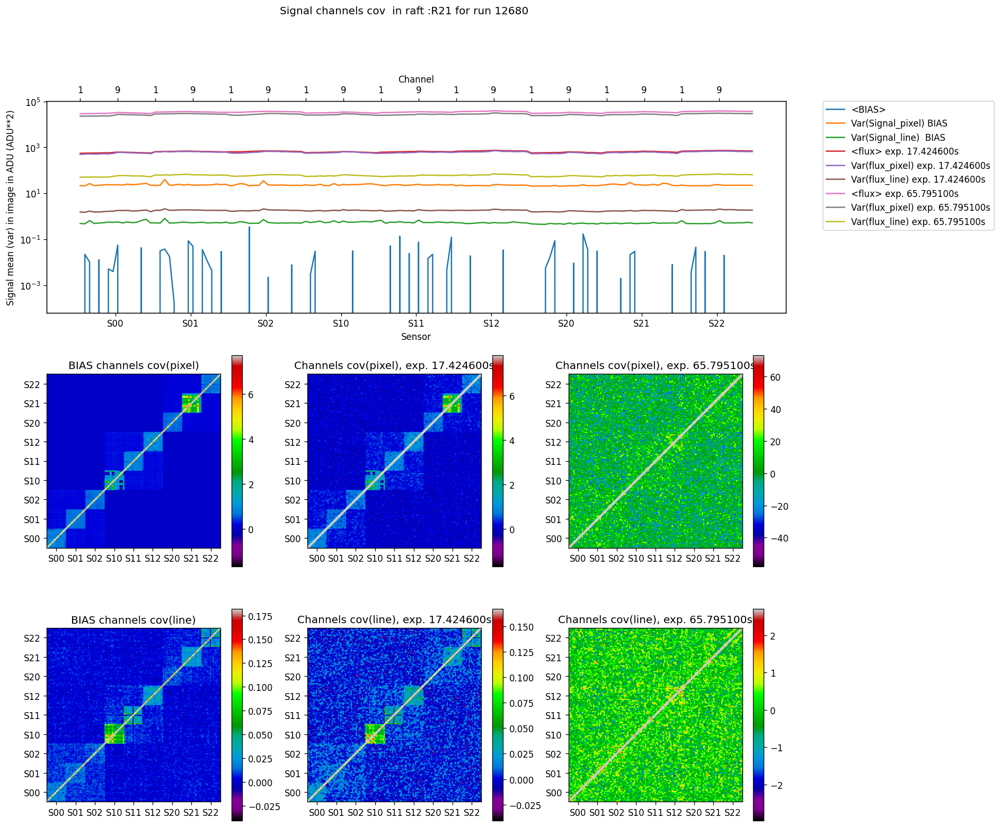

/home/antilog/DATA/eochar6/12680/R21/cor_in_signal.png
2021-01-23 07:37:48.126489  Run: 0  Raft: R22 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R22-S11-det094.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R22-S11-det094.fits 
2021-01-23 07:55:55.159472  Run: 0  Raft: R22 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R22-S11-det094.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R22-S11-det094.fits 
/home/antilog/DATA/eochar6/12680/R22/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R22/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R22/S02/cor_in_sig

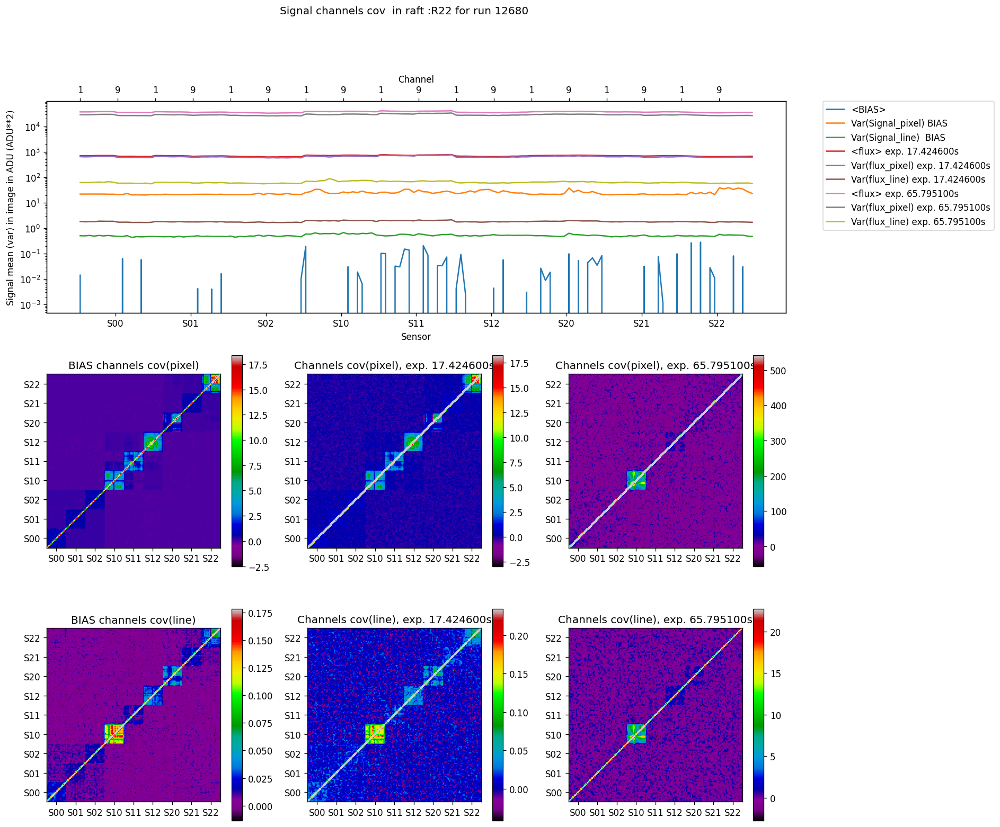

/home/antilog/DATA/eochar6/12680/R22/cor_in_signal.png


/home/antilog/repos/eochar/python/lsst/eochar/bot_frame_op.py:140: RuntimeWarning: invalid value encountered in true_divide
  self.all_file.append(actfile(fitsfile,Slow))
/home/antilog/repos/eochar/python/lsst/eochar/bot_frame_op.py:141: RuntimeWarning: invalid value encountered in true_divide
  self.selection.append((selection,filenamed))


2021-01-23 08:23:01.894962  Run: 0  Raft: R23 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R23-S11-det103.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R23-S11-det103.fits 
2021-01-23 08:40:51.057636  Run: 0  Raft: R23 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R23-S11-det103.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R23-S11-det103.fits 
/home/antilog/DATA/eochar6/12680/R23/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R23/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R23/S02/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R23/S10/cor_in

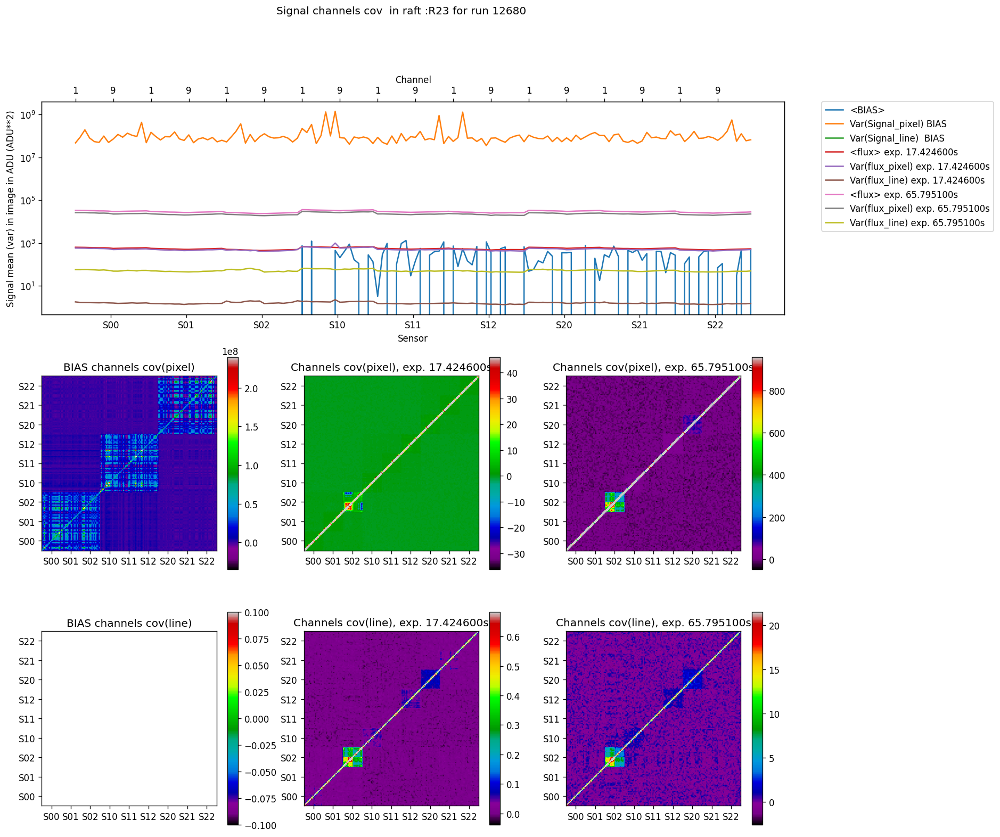

/home/antilog/DATA/eochar6/12680/R23/cor_in_signal.png
2021-01-23 09:07:27.665362  Run: 0  Raft: R24 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R24-S11-det112.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R24-S11-det112.fits 
2021-01-23 09:25:11.969999  Run: 0  Raft: R24 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R24-S11-det112.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R24-S11-det112.fits 
/home/antilog/DATA/eochar6/12680/R24/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R24/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R24/S02/cor_in_sig

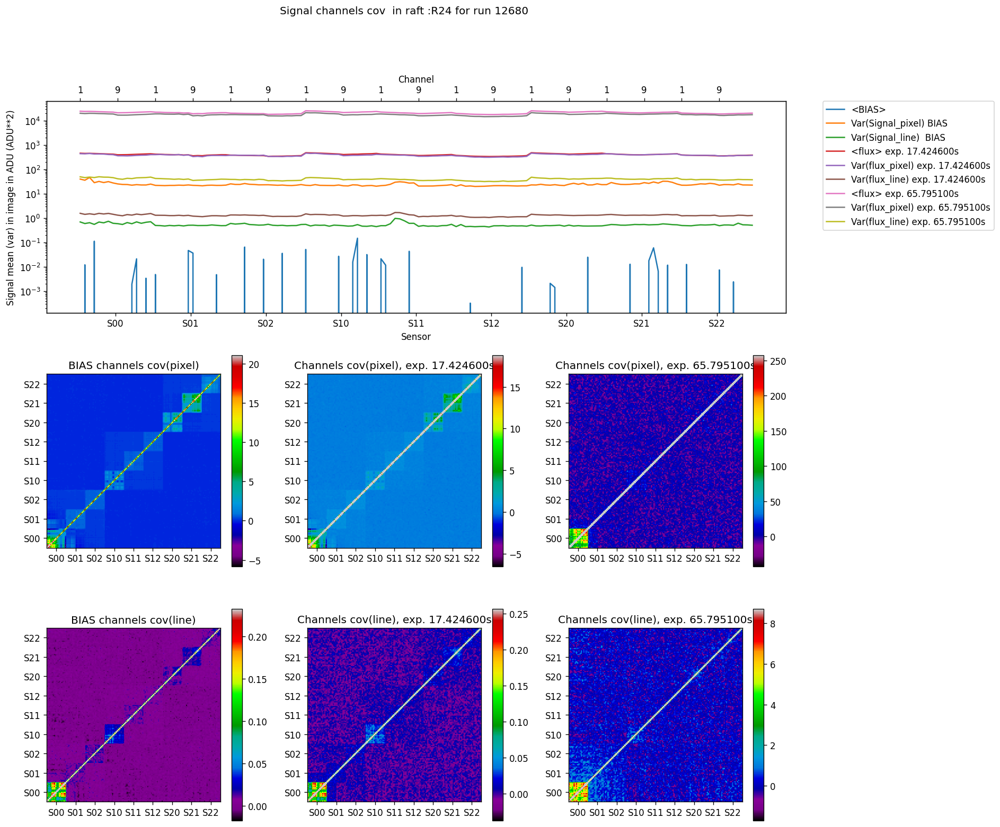

/home/antilog/DATA/eochar6/12680/R24/cor_in_signal.png
2021-01-23 09:52:21.025400  Run: 0  Raft: R30 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R30-S11-det121.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R30-S11-det121.fits 
2021-01-23 10:10:28.733234  Run: 0  Raft: R30 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R30-S11-det121.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R30-S11-det121.fits 
/home/antilog/DATA/eochar6/12680/R30/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R30/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R30/S02/cor_in_sig

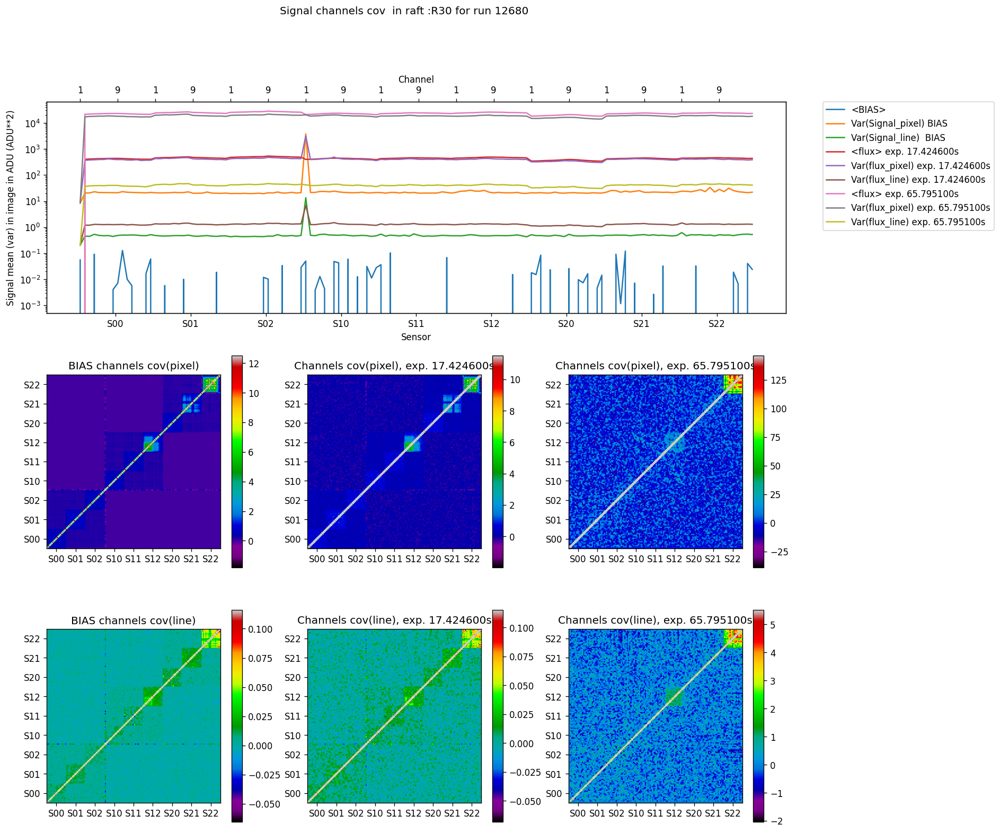

/home/antilog/DATA/eochar6/12680/R30/cor_in_signal.png
2021-01-23 10:37:17.556667  Run: 0  Raft: R31 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R31-S11-det130.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R31-S11-det130.fits 
2021-01-23 10:55:01.841981  Run: 0  Raft: R31 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R31-S11-det130.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R31-S11-det130.fits 
/home/antilog/DATA/eochar6/12680/R31/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R31/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R31/S02/cor_in_sig

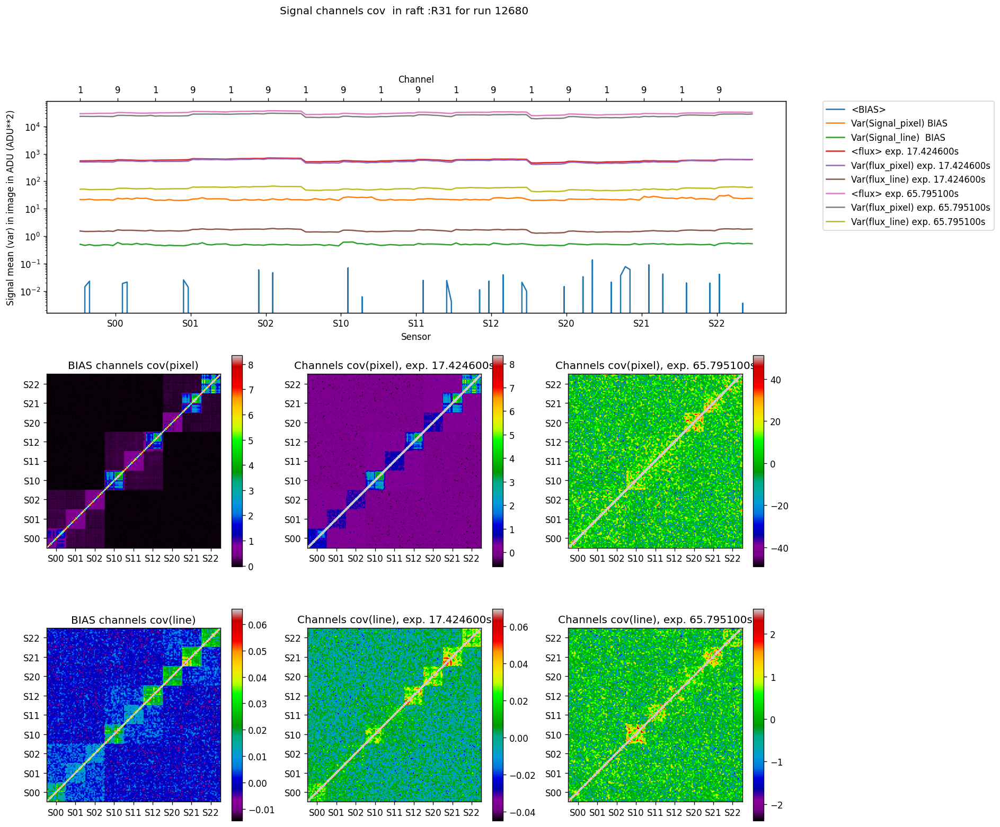

/home/antilog/DATA/eochar6/12680/R31/cor_in_signal.png
2021-01-23 11:21:49.898850  Run: 0  Raft: R32 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R32-S11-det139.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R32-S11-det139.fits 
2021-01-23 11:39:43.847343  Run: 0  Raft: R32 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R32-S11-det139.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R32-S11-det139.fits 
/home/antilog/DATA/eochar6/12680/R32/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R32/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R32/S02/cor_in_sig

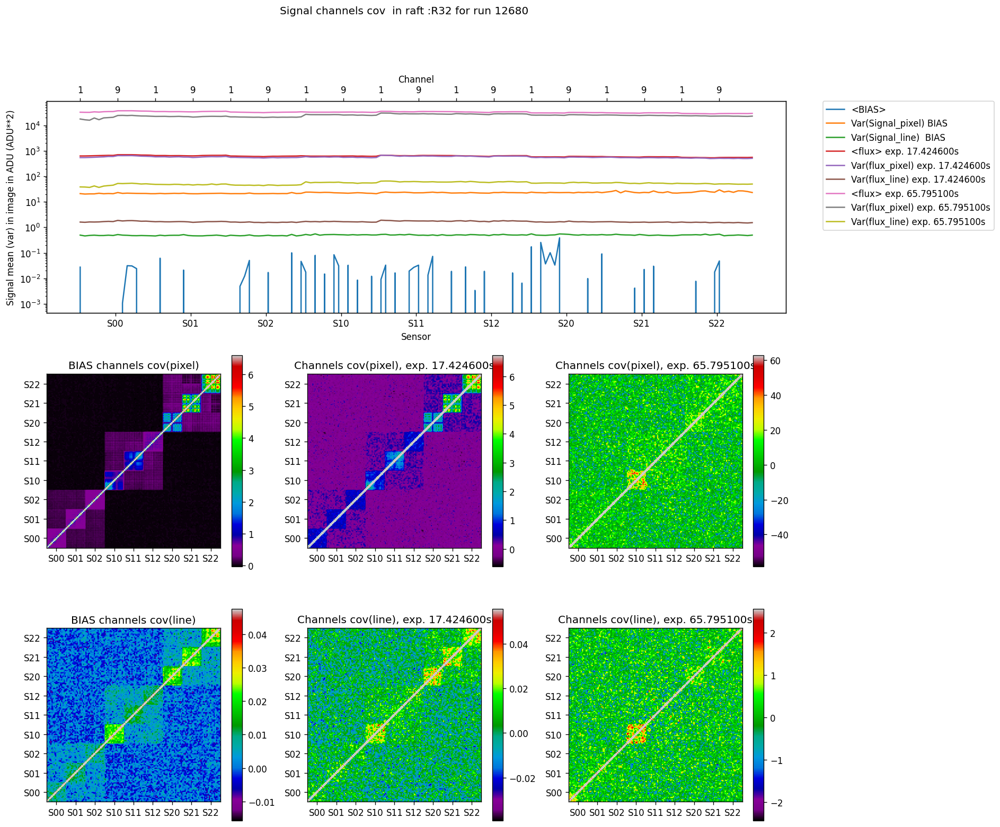

/home/antilog/DATA/eochar6/12680/R32/cor_in_signal.png
2021-01-23 12:06:36.002164  Run: 0  Raft: R33 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R33-S11-det148.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R33-S11-det148.fits 


/home/antilog/repos/eochar/python/lsst/eochar/bot_frame_op.py:112: RuntimeWarning: divide by zero encountered in true_divide
  if not ( local_keep ) : break
/home/antilog/repos/eochar/python/lsst/eochar/bot_frame_op.py:112: RuntimeWarning: invalid value encountered in true_divide
  if not ( local_keep ) : break
/opt/lsst/software/stack/conda/miniconda3-py37_4.8.2/envs/lsst-scipipe-cb4e2dc/lib/python3.7/site-packages/numpy/core/_methods.py:160: RuntimeWarning: invalid value encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims)
/opt/lsst/software/stack/conda/miniconda3-py37_4.8.2/envs/lsst-scipipe-cb4e2dc/lib/python3.7/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in reduce
  arrmean = umr_sum(arr, axis, dtype, keepdims=True)
/home/antilog/repos/eochar/python/lsst/eochar/bot_frame_op.py:119: RuntimeWarning: invalid value encountered in multiply
  local_keep=False
/home/antilog/repos/eochar/python/lsst/eochar/bot_frame_op.py:140: Runt

2021-01-23 12:24:33.949016  Run: 0  Raft: R33 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R33-S11-det148.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R33-S11-det148.fits 


/home/antilog/repos/eochar/python/lsst/eochar/bot_frame_op.py:119: RuntimeWarning: invalid value encountered in double_scalars
  local_keep=False
/home/antilog/repos/eochar/python/lsst/eochar/bot_frame_op.py:140: RuntimeWarning: invalid value encountered in true_divide
  self.all_file.append(actfile(fitsfile,Slow))
/home/antilog/repos/eochar/python/lsst/eochar/bot_frame_op.py:141: RuntimeWarning: invalid value encountered in true_divide
  self.selection.append((selection,filenamed))


/home/antilog/DATA/eochar6/12680/R33/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R33/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R33/S02/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R33/S10/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R33/S11/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R33/S12/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R33/S20/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R33/S21/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R33/S22/cor_in_signal.png


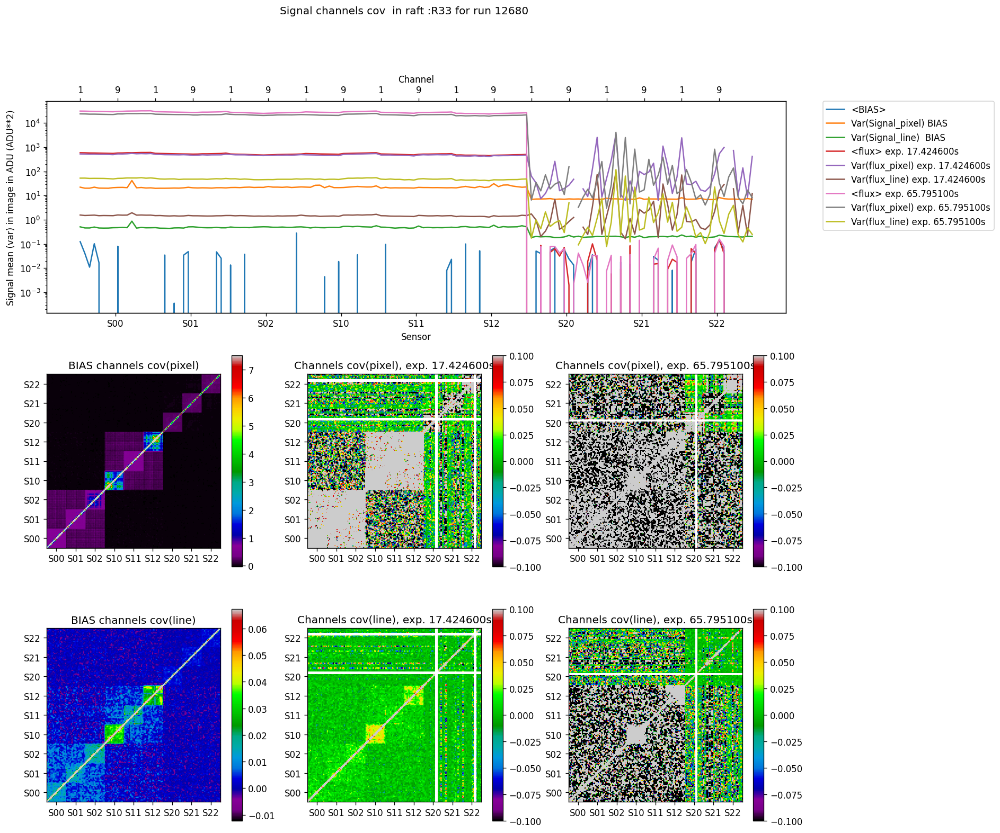

/home/antilog/DATA/eochar6/12680/R33/cor_in_signal.png
2021-01-23 12:51:31.109860  Run: 0  Raft: R34 ; pair of file number: 10  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300048/3020110300048-R34-S11-det157.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300049/3020110300049-R34-S11-det157.fits 
2021-01-23 13:09:23.538430  Run: 0  Raft: R34 ; pair of file number: 20  among: 24  current raft channels  65  processed among  144
0 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300068/3020110300068-R34-S11-det157.fits 
1 : Selected Main File /lsstdata/offline/teststand/BOT/gen2repo/raw/2020-11-03/3020110300069/3020110300069-R34-S11-det157.fits 
/home/antilog/DATA/eochar6/12680/R34/S00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R34/S01/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R34/S02/cor_in_sig

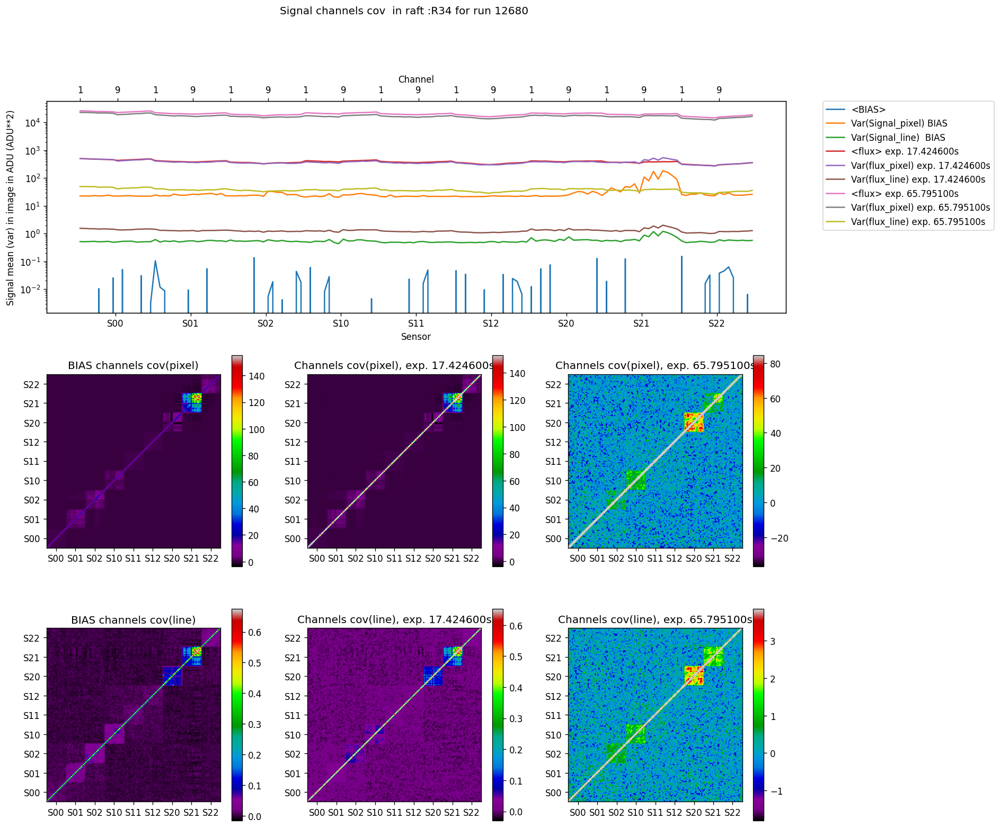

/home/antilog/DATA/eochar6/12680/R34/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R00/SG0/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R00/SG1/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R00/SW0/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R00/SW1/cor_in_signal.png


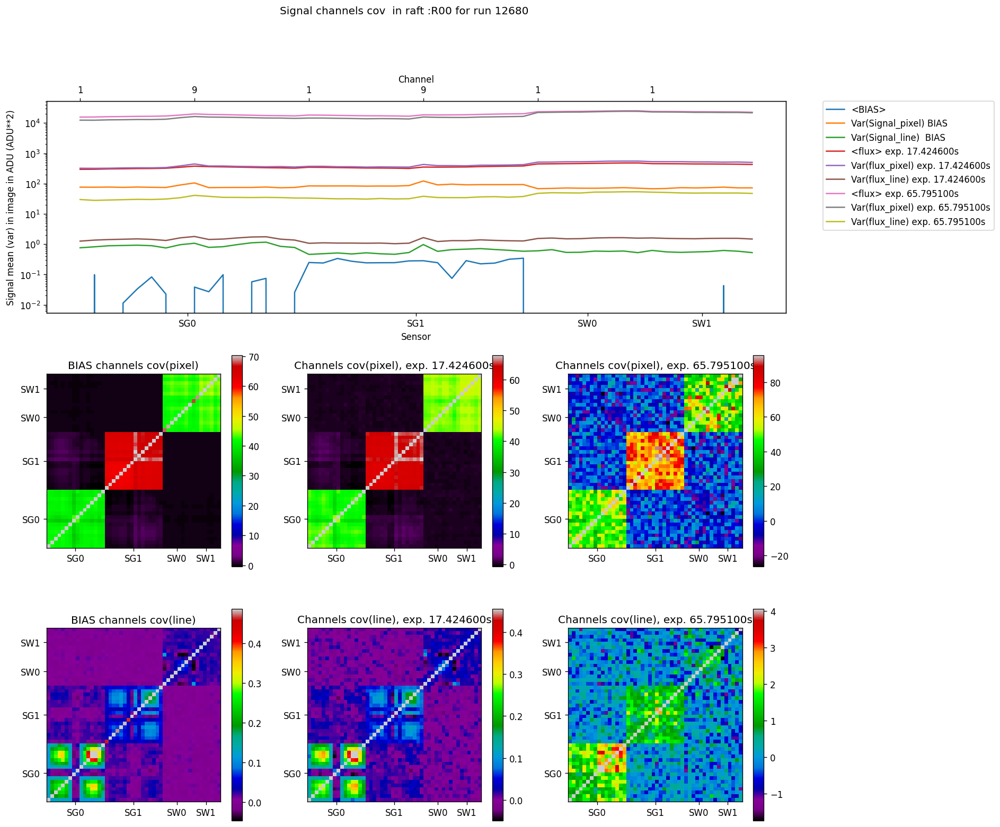

/home/antilog/DATA/eochar6/12680/R00/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R04/SG0/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R04/SG1/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R04/SW0/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R04/SW1/cor_in_signal.png


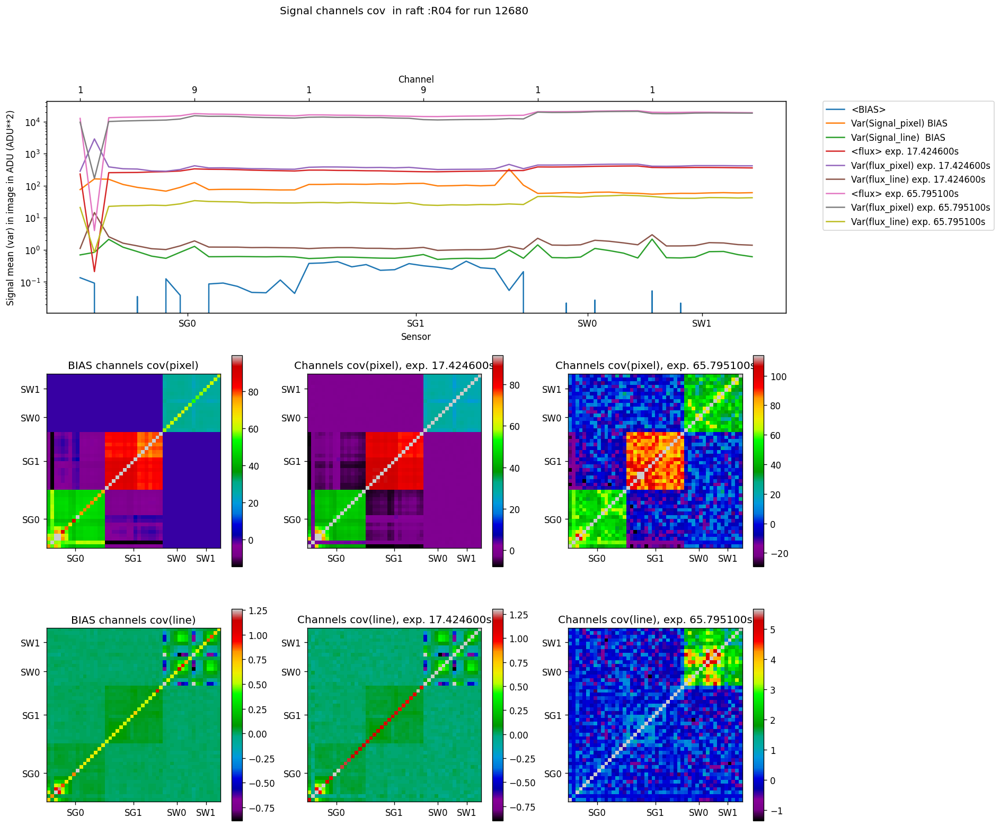

/home/antilog/DATA/eochar6/12680/R04/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R40/SG0/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R40/SG1/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R40/SW0/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R40/SW1/cor_in_signal.png


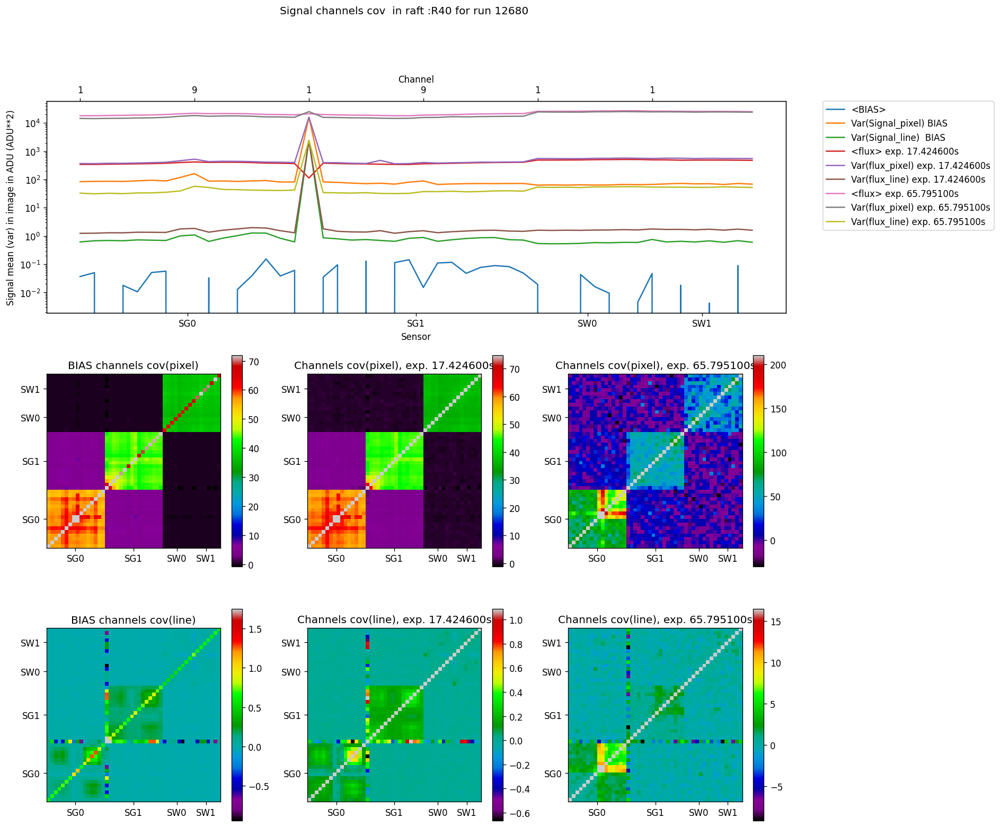

/home/antilog/DATA/eochar6/12680/R40/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R44/SG0/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R44/SG1/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R44/SW0/cor_in_signal.png
/home/antilog/DATA/eochar6/12680/R44/SW1/cor_in_signal.png


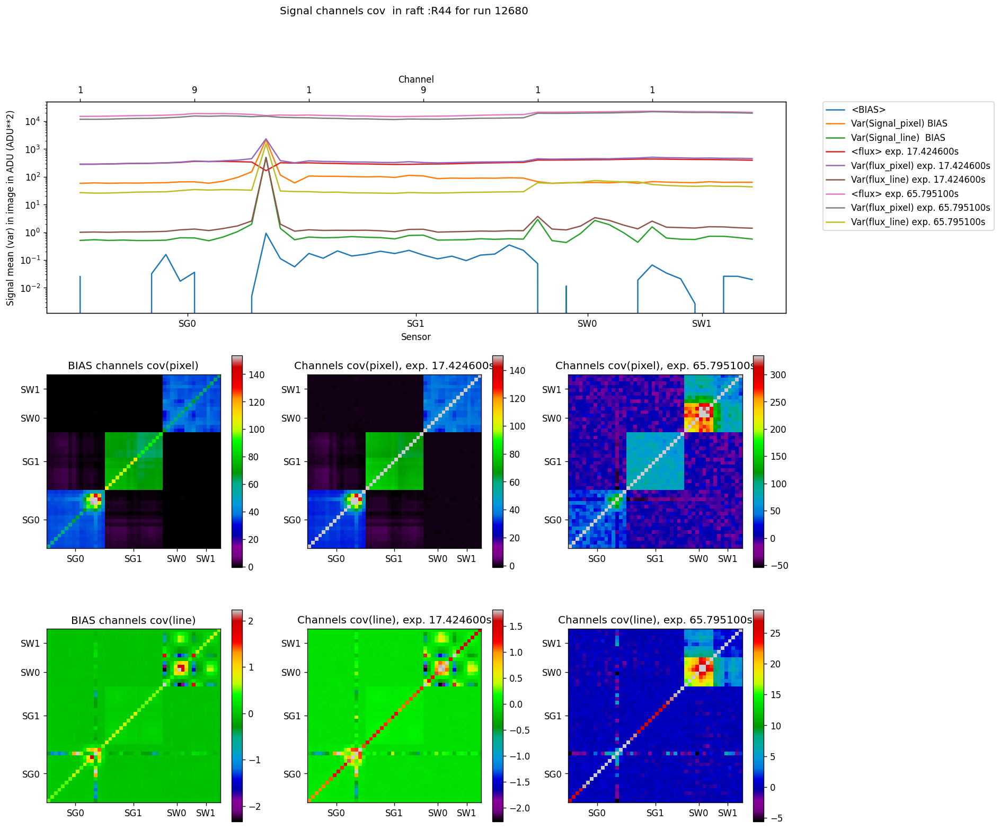

/home/antilog/DATA/eochar6/12680/R44/cor_in_signal.png


In [8]:
#noise=np.zeros((number_of_raft,number_of_run,number_of_sensor*16)) 
#noise_std=np.zeros((number_of_raft,number_of_run,number_of_sensor*16)) 
#cor=np.zeros((number_of_raft,number_of_run,144,144))
#
for iraft in range(len(raft)) :
    raft_cur=raft[iraft]
    # find all the files to compute the correlation between channels
    all_file=find_pair(raft_cur)
    # do all the correlation plots for this raft and all run 
    sig_cor_in_raft(raft_cur,all_file,show_raft=True,show_ccd=False,per_sensor=True)
    #